In [ ]:
import folium
import geopandas as gpd
import pandas as pd
# 1. Leer comunas
comunas = gpd.read_file("/home/miguel/codigo/club_de_datos_1c2025/2ndo_encuentro/data/comunas.geojson")
# 2. Lista de colores a usar (distintos del azul y naranja que ya usás)
colores_disponibles = [
    "#1b9e77", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00",
    "#ffff33", "#a65628", "#f781bf", "#999999", "#66c2a5",
    "#fc8d62", "#8da0cb", "#e78ac3", "#a6d854", "#ffd92f"
]
# Nos aseguramos de tener suficientes colores para todas las comunas
if len(colores_disponibles) < len(comunas):
    raise ValueError("No hay suficientes colores definidos para todas las comunas.")
# 3. Crear mapa base
m = folium.Map(location=[-34.61, -58.44], zoom_start=11, tiles="cartodbpositron")
# 4. Asignar color a cada comuna
for idx, row in comunas.iterrows():
    color = colores_disponibles[idx]
    folium.GeoJson(
        row["geometry"],
        name=f"Comuna {row['comuna']}",  # o el campo correspondiente si no es "COMUNA"
        style_function=lambda feat, col=color: {
            "fillColor": col,
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5,
        },
        tooltip=f"Comuna {row['comuna']}"
    ).add_to(m)
    
espacios_publicos_path = "/home/miguel/codigo/club_de_datos_1c2025/2ndo_encuentro/data/espacios_verdes_publicos.geojson" 
espacios_privados_path = "/home/miguel/codigo/club_de_datos_1c2025/2ndo_encuentro/data/espacios_verdes_privados.geojson"

folium.GeoJson(
    espacios_publicos_path,
    name="Espacios Públicos",
    tooltip=folium.GeoJsonTooltip(
        fields=["nombre","area"],   # Ajusta al nombre de tu propiedad para el tooltip
        aliases=["Nombre:","Area (m2)"],
        localize=True
    ),
    smooth_factor=2.0,       # mayor = más suavizado
    style_function=lambda fea: {
        "fillColor": "#228B22",
        "color": "black",
        "weight": 0.5,
        "fillOpacity": 0.6
    }
).add_to(m)

folium.GeoJson(
    espacios_privados_path,
    name="Espacios Privados",
    tooltip=folium.GeoJsonTooltip(
        fields=["nombre","area"],  
        aliases=["Nombre:","Area (m2)"],
        localize=True
    ),
    smooth_factor=2.0,       # mayor = más suavizado
    style_function=lambda fea: {
        "fillColor": "#C51D34",
        "color": "black",
        "weight": 0.5,
        "fillOpacity": 0.6
    }
).add_to(m)

folium.LayerControl().add_to(m)
m.save("mapa_zonas_verdes_caba.html")
m


In [2]:
espacios_verdes = gpd.read_file("/home/miguel/codigo/club_de_datos_1c2025/2ndo_encuentro/data/espacios_verdes_publicos.geojson")
comunas_numero2nombre = {
    1: "Retiro, San Nicolás, Puerto Madero, San Telmo, Monserrat, Constitución",
    2: "Recoleta",
    3: "Balvanera, San Cristóbal",
    4: "La Boca, Barracas, Parque Patricios, Nueva Pompeya",
    5: "Almagro, Boedo",
    6: "Caballito",
    7: "Flores, Parque Chacabuco",
    8: "Villa Soldati, Villa Riachuelo, Villa Lugano",
    9: "Liniers, Mataderos, Parque Avellaneda",
    10: "Villa Real, Monte Castro, Versalles, Floresta, Vélez Sarsfield, Villa Luro",
    11: "Villa General Mitre, Villa Devoto, Villa del Parque, Agronomía",
    12: "Coghlan, Saavedra, Villa Urquiza, Villa Pueyrredón",
    13: "Núñez, Belgrano, Colegiales",
    14: "Palermo",
    15: "Chacarita, Villa Crespo, La Paternal, Villa Ortúzar, Agronomía, Parque Chas"
}


In [3]:
areas_comunas = {i: 0 for i in range(1, 16)}
for idx, fila in espacios_verdes.iterrows():
    metros_cuadrados = fila.area
    areas_comunas[fila.comuna] = areas_comunas[fila.comuna] + metros_cuadrados


In [4]:
for clave, valor in areas_comunas.items():
    areas_comunas[clave] = int(valor)

In [5]:
areas_comunas

{1: 3242730,
 2: 337639,
 3: 46455,
 4: 719367,
 5: 22887,
 6: 175330,
 7: 356218,
 8: 3897020,
 9: 734275,
 10: 1261431,
 11: 111111,
 12: 1049549,
 13: 1576390,
 14: 2235071,
 15: 219493}

In [6]:
poblacion_2022 = {
    1: 223_554,
    2: 161_645,
    3: 196_240,
    4: 229_240,
    5: 194_271,
    6: 203_043,
    7: 215_896,
    8: 204_367,
    9: 169_063,
    10: 173_004,
    11: 204_601,
    12: 236_887,
    13: 264_385,
    14: 248_635,
    15: 196_876
}
poblacion_2022

{1: 223554,
 2: 161645,
 3: 196240,
 4: 229240,
 5: 194271,
 6: 203043,
 7: 215896,
 8: 204367,
 9: 169063,
 10: 173004,
 11: 204601,
 12: 236887,
 13: 264385,
 14: 248635,
 15: 196876}

In [7]:
df = pd.DataFrame({
    'comuna' : list(areas_comunas.keys()),
    'nombre' : list(comunas_numero2nombre.values()),
    'm2' : list(areas_comunas.values()),
    'poblacion' : list(poblacion_2022.values())
})
df

,comuna,nombre,m2,poblacion
0,1,"Retiro, San Nicolás, Puerto Madero, San Telmo,...",3242730,223554
1,2,Recoleta,337639,161645
2,3,"Balvanera, San Cristóbal",46455,196240
3,4,"La Boca, Barracas, Parque Patricios, Nueva Pom...",719367,229240
4,5,"Almagro, Boedo",22887,194271
5,6,Caballito,175330,203043
6,7,"Flores, Parque Chacabuco",356218,215896
7,8,"Villa Soldati, Villa Riachuelo, Villa Lugano",3897020,204367
8,9,"Liniers, Mataderos, Parque Avellaneda",734275,169063
9,10,"Villa Real, Monte Castro, Versalles, Floresta,...",1261431,173004


/tmp/ipykernel_35509/1890351060.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_sorted, x="comuna", y="m2", palette="viridis")


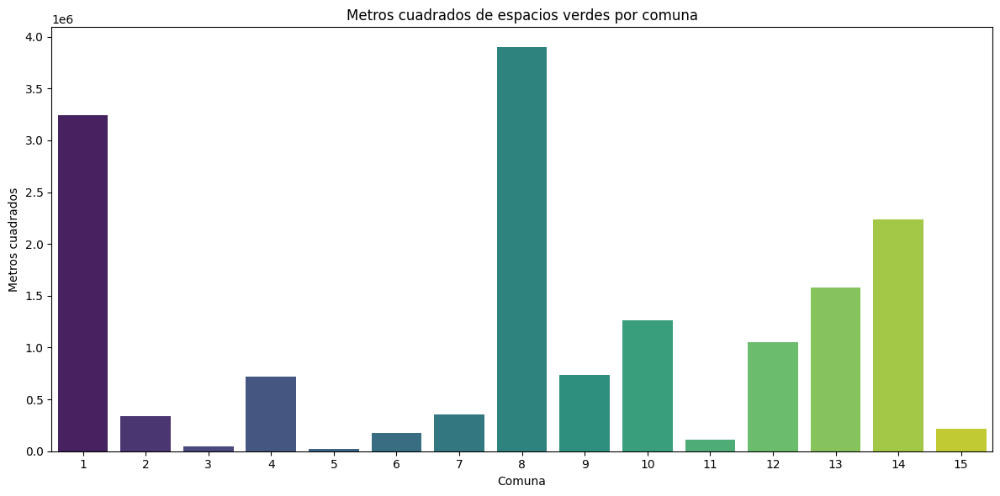

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

df_sorted = df.sort_values("m2", ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(data=df_sorted, x="comuna", y="m2", palette="viridis")
plt.title("Metros cuadrados de espacios verdes por comuna")
plt.xlabel("Comuna")
plt.ylabel("Metros cuadrados")
plt.tight_layout()
plt.show()


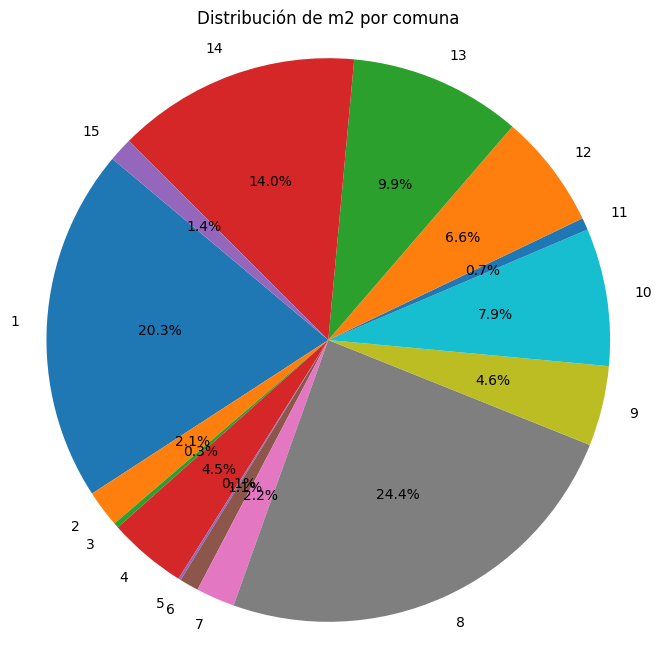

In [9]:
plt.figure(figsize=(8, 8))
plt.pie(df["m2"], labels=df["comuna"], autopct="%1.1f%%", startangle=140)
plt.title("Distribución de m2 por comuna")
plt.axis("equal")  # para que sea un círculo
plt.show()


In [2]:
plt.figure(figsize=(10, 8))
sns.barplot(data=df.sort_values("m2"), y="nombre", x="m2", palette="magma")
plt.title("Espacio verde por nombre de comuna")
plt.xlabel("Metros cuadrados")
plt.ylabel("Comuna")
plt.tight_layout()
plt.show()


NameError: name 'plt' is not defined

In [1]:
df['m2_per_capita'] = df['m2'] / df['poblacion']

plt.figure(figsize=(10, 6))
sns.barplot(data=df.sort_values('m2_per_capita', ascending=False),
            x='comuna', y='m2_per_capita', palette='viridis')

plt.xlabel("Comuna")
plt.ylabel("Metros cuadrado por habitante (m²/hab)")
plt.title("Espacio verde por habitante (m²/hab) por comuna")
plt.tight_layout()
plt.show()


NameError: name 'df' is not defined

In [ ]:
import plotly.express as px

df['m2_per_capita'] = df['m2'] / df['poblacion']

fig = px.bar(
    df.sort_values('m2_per_capita', ascending=False),
    x='m2_per_capita',
    y='comuna',
    orientation='h',
    color='m2_per_capita',
    color_continuous_scale='viridis',
    labels={'m2_per_capita': 'm² por habitante', 'nombre': 'Comuna'},
    hover_data={
        'nombre': True,
        'm2': True,
        'poblacion': True,
        'm2_per_capita': ':.2f'
    },
    title='Espacio verde por habitante (m²/hab) por comuna'
)

fig.update_layout(yaxis=dict(categoryorder='total ascending'))
fig.show()
